In [1]:
import pandas as pd
import numpy as np
import os
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import Pipeline
from natsort import natsorted
from scipy.stats import pearsonr
import seaborn as sns
import matplotlib.cm as cm
from pygam import LinearGAM, s, f
import statsmodels.api as sm
from scipy import stats
sns.set(font_scale=1.5, style="white")

In [2]:
df = pd.read_csv('../../Dataset/childhood/rna/brodmann_schaefer_0.5.csv')
df_copy = df.iloc[:200, 2:]
df.iloc[:200, 2:] = df.iloc[:200, 2:].values + df.iloc[200:, 2:].values
df.iloc[200:, 2:] = df_copy.values + df.iloc[200:, 2:].values

In [3]:
regionname = pd.read_csv('../../Dataset/childhood/atlas/schaefer400_regions.csv')
sarank = pd.read_csv('../../Dataset/childhood/saaxis/Sensorimotor_Association_Axis_AverageRanks.csv')
sarank = pd.concat([regionname.reset_index(drop=True), sarank.reset_index(drop=True)],axis=1)
sarank = sarank.loc[:, ['name', 'finalrank.wholebrain']]

In [4]:
# read expression data
data_dir = '../../Dataset/childhood/rna'
gene_columns = pd.read_csv(os.path.join(data_dir, 'columns_metadata.csv'))
gene_rows = pd.read_csv(os.path.join(data_dir, 'rows_metadata.csv'))
gene_columns['id'] = range(1, len(gene_columns) + 1)
expr_matrix = pd.read_csv(os.path.join(data_dir, 'expression_matrix.csv'), header=None)
expr_matrix = expr_matrix.iloc[:, 1:] 

In [5]:
# remove genes without an entrez id
expr_subset = expr_matrix[~gene_rows['entrez_id'].isna()]
rows_subset = gene_rows[~gene_rows['entrez_id'].isna()]

In [6]:
log2_expr = np.log2(expr_subset + 1)
log2_expr['entrez_id'] = rows_subset['entrez_id']

In [7]:
for i, marker in enumerate(gene_rows.gene_symbol.unique()):
    if i % 1000 == 0:
        print(i)
    ids = gene_rows[gene_rows.gene_symbol==marker].entrez_id.values[0]
    df_marker = log2_expr[log2_expr.entrez_id==ids].iloc[:, :-1].T.values
    df_marker = df_marker.mean(axis=1)
    gene_columns[marker] = df_marker

0


<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

1000


<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

2000


<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

3000


<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

4000


<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

5000


<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

6000


<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

7000


<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

8000


<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

9000


<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` ma

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

10000


<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

11000


<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

12000


<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

13000


<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` ma

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` ma

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

14000


<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` ma

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` ma

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

15000


<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` ma

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` ma

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` ma

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` ma

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

16000


<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` ma

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

17000


<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` ma

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` ma

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

18000


<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` ma

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` ma

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

19000


/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` ma

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` ma

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

20000


<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` ma

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` ma

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

21000


<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

22000


<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

23000


/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

24000


<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` ma

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` ma

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

25000


<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

26000


/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

27000


<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

28000


<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

29000


/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

30000


/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

31000


<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

32000


<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

33000


<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

34000


<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` ma

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

35000


<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

36000


<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

37000


<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

38000


<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

39000


<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

40000


<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

41000


<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

42000


<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` ma

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

43000


/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

44000


<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

45000


<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

46000


<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

47000


<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: 

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at o

<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  gene_columns[marker] = df_marker
<ipython-input-7-37eea841b2ca>:6: RuntimeWarning: Mean of empty slice.
  df_marker = df_marker.mean(axis=1)
/Users/monaminishio/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-7-37eea841b2ca>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the

In [8]:
sa_cortex = np.unique([x for x in gene_columns.structure_name if 'cortex' in x])
sa_cortex = pd.DataFrame([x for x in sa_cortex if 'cereb' not in x])
sa_cortex.columns = ['structure_name']

In [9]:
adults = [ '18 yrs', '19 yrs', '21 yrs','23 yrs']
cbpd_wide = ['4 yrs', '8 yrs', '11 yrs','13 yrs']

In [10]:
brodregion = pd.read_csv('../../Dataset/childhood/rna/brodmann.csv')
saorder = pd.DataFrame([np.arange(11), ['Visual', 'Auditory', 'Sensory', 'Motor', 'IPC', 'STC', 'vPFC', 'dPFC', 'OFC', 'TEv', 'ACC']]).T
saorder.columns = ['sa', 'group']
#pd.merge(brodregion.iloc[:, :2], saorder, on='group', how='left').to_csv('../../Dataset/rna/brodmann.csv', index=False)

In [11]:
child_original = pd.read_csv('../../Derivatives/childhood/original_motion_1mm.csv')
adult_original = pd.read_csv('../../Derivatives/adult/original.csv')

In [12]:
Visual = [x for x in df.columns if 'BA17' in x]
Auditory = [x for x in df.columns if 'BA41' in x]
Sensory =  [x for x in df.columns if 'BA1_3' in x] + [x for x in df.columns if 'BA2' in x] # [x for x in sarank.name.values if 'S2' in x] +
Motor = [x for x in df.columns if 'BA4' in x]
vPFC = [x for x in df.columns if 'BA44' in x] +  [x for x in df.columns if 'BA45' in x]
dPFC = [x for x in df.columns if 'BA8' in x] + [x for x in df.columns if 'BA9' in x] + [x for x in df.columns if 'BA46' in x]
OFC = [x for x in df.columns if 'BA11' in x] + [x for x in df.columns if 'BA12' in x]+ [x for x in df.columns if 'BA13' in x]  + [x for x in df.columns if 'BA14_' in x]
TEv = [x for x in df.columns if 'BA20' in x]
ACC = [x for x in df.columns if 'BA24' in x] + [x for x in df.columns if 'BA25' in x] + [x for x in df.columns if 'BA32' in x]
STC = [x for x in df.columns if 'BA22' in x]
IPC = [x for x in df.columns if 'BA39' in x] +  [x for x in df.columns if 'BA40' in x]
child_regions = []
adult_regions = []
sas = []
for x in [Sensory, Auditory, Motor, Visual, vPFC, dPFC, OFC, TEv, ACC, STC, IPC]:
    print(x)
    roi  = df.loc[:, x].sum(axis=1)>0
    #if x == ['BA41_42_52']:
    #    roi[44] = True
    child_original['roi']=roi
    adult_original['roi']=roi
    child_regions.append(child_original[child_original.roi==True].mean()['H'])
    adult_regions.append(adult_original[adult_original.roi==True].mean()['H'])
    sas.append(child_original[child_original.roi==True].mean()['SArank'])

['BA1_3', 'BA2', 'BA20', 'BA21', 'BA22', 'BA23', 'BA24', 'BA25', 'BA26_29_30', 'BA27', 'BA28']
['BA41_42_52']
['BA4', 'BA40', 'BA41_42_52', 'BA43', 'BA44', 'BA45', 'BA46', 'BA47']
['BA17']
['BA44', 'BA45']
['BA8', 'BA9', 'BA46']
['BA11', 'BA13']
['BA20']
['BA24', 'BA25', 'BA32']
['BA22']
['BA39', 'BA40']


In [13]:
child = pd.DataFrame([['Sensory', 'Auditory', 'Motor', 'Visual', 'vPFC', 'dPFC', 'OFC', 'TEv', 'ACC', 'STC', 'IPC'], child_regions, sas]).T.sort_values(2).reset_index(drop=True)
child.columns = ['region', 'H', 'sa']
adult = pd.DataFrame([['Sensory', 'Auditory', 'Motor', 'Visual', 'vPFC', 'dPFC', 'OFC', 'TEv', 'ACC', 'STC', 'IPC'], adult_regions, sas]).T.sort_values(2).reset_index(drop=True)
adult.columns = ['region', 'H', 'sa']

In [14]:
sa_cortex['region'] = ['ACC', 'dPFC', 'TEv', '-', 'OFC', '-', 'STC', 'IPC', 'Auditory', 'Motor', '-', 'Sensory', 'Visual', '-', 'vPFC']
sa_cortex = pd.merge(sa_cortex.loc[:, ['structure_name', 'region']], child.loc[:, ['region', 'sa']], on='region', how='left')

In [15]:
gene_columns = pd.merge(gene_columns,sa_cortex, on='structure_name', how='left')
gene_columns = gene_columns.dropna(axis=1, how='all')

In [16]:
#gene_columns = gene_columns[gene_columns.sa>-1].sort_values('sa')
#gene_columns = gene_columns.loc[:, ['sa', 'donor_id']+list(gene_columns.columns[9:-2])+['age']]

In [17]:
gene_columns.to_csv('all_genes.csv', index=False)

In [66]:
age = adults
wide = gene_columns.loc[[x for x in gene_columns.index if gene_columns.loc[x,'age'] in age], :]
wide = wide[wide.sa>-1].sort_values('sa')
wide = wide.loc[:, ['sa', 'donor_id']+list(gene_columns.columns[9:-2])].groupby(['sa', 'donor_id']).median().reset_index()
wide = pd.merge(wide, gene_columns.loc[:, ['donor_id', 'age']], on='donor_id')    
wide_age = wide.loc[[x for x in wide.index if wide.loc[x,'age'] in age], :]
wide_mean = wide_age.iloc[:, :-1].groupby(['sa']).median().reset_index()
coef = []
pvalue = []
rsquare = []
for marker in enumerate(gene_columns.columns[9:-2]):
    marker = marker[1]
    X = sm.add_constant(wide_mean[marker].values)
    results = sm.OLS([float(x) for x in adult['H'].values], X).fit()
    coef.append(results.params[1])
    pvalue.append(results.pvalues[1])
    rsquare.append(results.rsquared_adj)

In [67]:
df_adult = pd.DataFrame([gene_columns.columns[9:-2], coef, pvalue, rsquare]).T
df_adult.columns = ['gene', 'coef', 'pvalue','rsquare']
df_adult = df_adult[df_adult.coef>0][df_adult.pvalue<0.05].sort_values('pvalue').reset_index(drop=True)

<ipython-input-67-c52fd85ca35e>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_adult = df_adult[df_adult.coef>0][df_adult.pvalue<0.05].sort_values('pvalue').reset_index(drop=True)


In [68]:
age = cbpd_wide
wide = gene_columns.loc[[x for x in gene_columns.index if gene_columns.loc[x,'age'] in age], :]
wide = wide[wide.sa>-1].sort_values('sa')
wide = wide.loc[:, ['sa', 'donor_id']+list(gene_columns.columns[9:-2])].groupby(['sa', 'donor_id']).median().reset_index()
wide = pd.merge(wide, gene_columns.loc[:, ['donor_id', 'age']], on='donor_id')    
wide_age = wide.loc[[x for x in wide.index if wide.loc[x,'age'] in age], :]
wide_mean = wide_age.iloc[:, :-1].groupby(['sa']).median().reset_index()
coef = []
pvalue = []
rsquare = []
for marker in enumerate(gene_columns.columns[9:-2]):
    marker = marker[1]
    X = sm.add_constant(wide_mean[marker].values)
    results = sm.OLS([float(x) for x in child['H'].values], X).fit()
    coef.append(results.params[1])
    pvalue.append(results.pvalues[1])
    rsquare.append(results.rsquared_adj)

In [69]:
df_child = pd.DataFrame([gene_columns.columns[9:-2], coef, pvalue, rsquare]).T
df_child.columns = ['gene', 'coef', 'pvalue','rsquare']
df_child = df_child[df_child.coef>0][df_child.pvalue<0.05].sort_values('pvalue').reset_index(drop=True)

<ipython-input-69-7333bb2c740f>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_child = df_child[df_child.coef>0][df_child.pvalue<0.05].sort_values('pvalue').reset_index(drop=True)


In [71]:
df_combine = pd.merge(df_adult, df_child, on='gene', how='inner')
df_combine.to_csv('combine.csv', index=False)

In [27]:
df_combine =  df_combine.sort_values(['pvalue_x', 'pvalue_y']).reset_index(drop=True)

In [28]:
info = pd.read_csv(os.path.join(data_dir, 'rows_metadata.csv'))
geneid = []
for x in df_combine.gene:
    geneid.append(info[info.gene_symbol==x].ensembl_gene_id.values[0])

In [29]:
df_combine[df_combine.gene=='PVALB']

,gene,coef_x,pvalue_x,rsquare_x,coef_y,pvalue_y,rsquare_y
17,PVALB,0.02471,0.01757,0.425789,0.018409,0.030064,0.359704


In [30]:
df_combine_adult = df_combine.sort_values(['pvalue_x']).reset_index(drop=True)
df_combine_adult[df_combine_adult.gene=='PVALB']

,gene,coef_x,pvalue_x,rsquare_x,coef_y,pvalue_y,rsquare_y
17,PVALB,0.02471,0.01757,0.425789,0.018409,0.030064,0.359704


In [31]:
df_combine['ensembl_gene_id'] = geneid

In [32]:
stronger = df_combine[df_combine.rsquare_x>0.425789][df_combine.rsquare_y>0.359704]
stronger.shape

<ipython-input-32-a841037e08e1>:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  stronger = df_combine[df_combine.rsquare_x>0.425789][df_combine.rsquare_y>0.359704]


(9, 8)

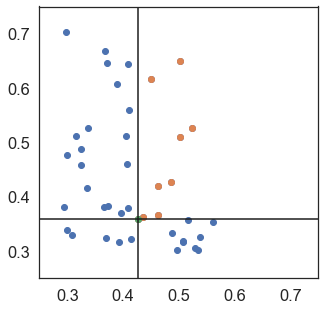

In [33]:
figure = plt.figure(figsize=(5,5))
plt.scatter(df_combine.rsquare_x, df_combine.rsquare_y)
plt.scatter(stronger.rsquare_x, stronger.rsquare_y)
plt.scatter(0.425789, 0.359704)
plt.plot([0.425789,0.425789], [0.25, 0.75], 'k')
plt.plot([0.25,0.75], [0.359704, 0.359704], 'k')
plt.xlim([0.25,0.75])
plt.ylim([0.25,0.75])
plt.savefig('adult_child.eps')

In [28]:
stronger.to_csv('stronger.csv', index=False)

In [29]:
stronger = pd.read_csv('stronger.csv')

In [30]:
df = pd.read_csv('stronger_go.csv')

In [32]:
go = df.T.iloc[1:, :]
go['ensembl_gene_id'] = go.index

In [33]:
stronger = pd.merge(stronger, go, on='ensembl_gene_id')

In [34]:
alls = []
for x in stronger.iloc[:-1, 8:].values:
    alls += list(x)

In [58]:
age = adults
wide = gene_columns.loc[[x for x in gene_columns.index if gene_columns.loc[x,'age'] in age], :]
wide = wide[wide.sa>-1].sort_values('sa')
wide = wide.loc[:, ['sa', 'donor_id']+list(gene_columns.columns[9:-2])].groupby(['sa', 'donor_id']).median().reset_index()
wide = pd.merge(wide, gene_columns.loc[:, ['donor_id', 'age']], on='donor_id')    
wide_age = wide.loc[[x for x in wide.index if wide.loc[x,'age'] in age], :]
wide_mean = wide_age.iloc[:, :-1].groupby(['sa']).median().reset_index()
coef = []
pvalue = []
rsquare = []
for marker in enumerate(gene_columns.columns[9:-2]):
    marker = marker[1]
    X = sm.add_constant(wide_mean[marker].values)
    results = sm.OLS([1,2,7,3,9,4,6,8,10,11,5], X).fit()
    coef.append(results.params[1])
    pvalue.append(results.pvalues[1])
    rsquare.append(results.rsquared_adj)

In [59]:
df_adult = pd.DataFrame([gene_columns.columns[9:-2], coef, pvalue, rsquare]).T
df_adult.columns = ['gene', 'coef', 'pvalue','rsquare']
df_adult = df_adult[df_adult.pvalue<0.05].sort_values('pvalue').reset_index(drop=True) #[df_adult.coef<0]

<ipython-input-59-3785d4608990>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_adult = df_adult[df_adult.coef<0][df_adult.pvalue<0.05].sort_values('pvalue').reset_index(drop=True)


In [60]:
age = cbpd_wide
wide = gene_columns.loc[[x for x in gene_columns.index if gene_columns.loc[x,'age'] in age], :]
wide = wide[wide.sa>-1].sort_values('sa')
wide = wide.loc[:, ['sa', 'donor_id']+list(gene_columns.columns[9:-2])].groupby(['sa', 'donor_id']).median().reset_index()
wide = pd.merge(wide, gene_columns.loc[:, ['donor_id', 'age']], on='donor_id')    
wide_age = wide.loc[[x for x in wide.index if wide.loc[x,'age'] in age], :]
wide_mean = wide_age.iloc[:, :-1].groupby(['sa']).median().reset_index()
coef = []
pvalue = []
rsquare = []
for marker in enumerate(gene_columns.columns[9:-2]):
    marker = marker[1]
    X = sm.add_constant(wide_mean[marker].values)
    results = sm.OLS([1,2,7,3,9,4,6,8,10,11,5], X).fit()
    coef.append(results.params[1])
    pvalue.append(results.pvalues[1])
    rsquare.append(results.rsquared_adj)

In [61]:
df_child = pd.DataFrame([gene_columns.columns[9:-2], coef, pvalue, rsquare]).T
df_child.columns = ['gene', 'coef', 'pvalue','rsquare']
df_child = df_child[df_child.pvalue<0.05].sort_values('pvalue').reset_index(drop=True) #[df_child.coef<0]

<ipython-input-61-2a05f30440d3>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_child = df_child[df_child.coef<0][df_child.pvalue<0.05].sort_values('pvalue').reset_index(drop=True)


In [62]:
df_combine_SA = pd.merge(df_adult, df_child, on='gene', how='inner')

In [63]:
[x for x in df_combine_SA.gene.values if x in df_combine.gene.values]

['PVALB', 'KCNS1', 'JDP2', 'ITIH5']

In [53]:
[x for x in df_combine_SA.gene.values if x in df_combine.gene.values]

['PVALB', 'KCNS1', 'JDP2', 'ITIH5']